# import

In [1]:
import itstgcn_intro

import torch
import numpy as np
import pandas as pd

import random

from plotnine import *
import pickle

import plotly.express as px
import plotly.graph_objects as go

import matplotlib.pyplot as plt


import torch_geometric_temporal

In [2]:
def load_data(fname):
    with open(fname, 'rb') as outfile:
        data_dict = pickle.load(outfile)
    return data_dict

def save_data(data_dict,fname):
    with open(fname,'wb') as outfile:
        pickle.dump(data_dict,outfile)

# Data

In [ ]:
T = 10000
t = np.arange(T)/T * 5

In [ ]:
np.random.seed(111)
node0 = 2*np.sin(4*t)+np.sin(4*t)
eps_node0  = np.random.normal(size=T)*0.7

In [ ]:
np.random.seed(22)
node1 = node0.copy()
# for i in range(2,T):
#     y[i] = 0.7*x[i-1] - 0.25*x[i-2] + 0.5*np.cos(0.1*t[i]) 
eps_node1  = np.random.normal(size=T)*0.7

In [ ]:
plt.plot(t,node0,color='C0',lw=2)
plt.plot(t,node0+eps_node0,alpha=0.5,color='C0')

In [ ]:
plt.plot(t,node1,color='C1',lw=2)
plt.plot(t,node1+eps_node1,alpha=0.5,color='C1')

In [ ]:
_node_ids = {'node0':0, 'node1':1}

_FX1 = np.stack([node0+eps_node0,node1+eps_node1],axis=1).tolist()

_edges1 = torch.tensor([[0,1]]).tolist()

data_dict1 = {'edges':_edges1, 'node_ids':_node_ids, 'FX':_FX1}
data1 = pd.DataFrame({'node0':node0,'node1':node1,'node0_noise':eps_node0,'node1_noise':eps_node1,'node0_observed':node0+eps_node0,'node1_observed':node1+eps_node1})

# save_data(data_dict1, './data/new_toy_dict.pkl')
# save_data(data1, './data/new_toy_data.csv')

# Class

In [52]:
class Intro:
    def __init__(self, data, lags, mindex, mtype, name):
        self.loader = loader3
        # self.data_dict = data_dict
        self.nodes = len(loader3.get_dataset(lags=8).features[0])
        self.T = len(loader3.get_dataset(lags=8).targets)
        self.lags=lags
        self.mindex=mindex
        self.mtype=mtype
        self.name = name
        
        # self.observed_values = []

        # for node in range(self.nodes):
        #     self.observed_values.append({
        #         f'node{node}': data[f'node{node}'],
        #         f'node{node}_noise': data[f'node{node}_noise'],
        #         f'node{node}_observed': data[f'node{node}_observed']
        #     })
        
        self.dataset = self.loader.get_dataset(lags=self.lags)
        self.train_dataset, self.test_dataset= torch_geometric_temporal.signal.temporal_signal_split(self.dataset, train_ratio=0.8)
        self.dataset_miss = itstgcn_intro.miss(self.dataset,self.mindex,mtype=self.mtype)
        self.dataset_padded = itstgcn_intro.padding(self.dataset_miss,interpolation_method='linear')

    def lrnr(self, filters, epoch=5):
        self.epoch = epoch
        
        if self.name == 'Classic' :
            self.lrnr = itstgcn_intro.StgcnLearner(self.dataset_padded)
        elif self.name == 'Proposed' :
            self.lrnr = itstgcn_intro.ITStgcnLearner(self.dataset_padded)
            
        self.lrnr.learn(filters, epoch)

    def record_yhat(self):
        results = self.lrnr.result_dict
        dfs_by_node = {}
    
        for node in range(0, self.nodes):
            df_node = pd.DataFrame()
            
            # df_node[f'node{node}_underline'] = self.observed_values[node][f'node{node}'][:-self.lags]
            # df_node[f'node{node}_noise'] = self.observed_values[node][f'node{node}_noise'][:-self.lags]
            # df_node[f'node{node}_observed'] = self.observed_values[node][f'node{node}_observed'][:-self.lags]
            # df_node[f'node{node}_missing'] = torch.tensor(self.dataset_miss.targets).reshape(-1,self.nodes)[:,node]
            # df_node[f'node{node}_padding'] = torch.tensor(self.dataset_padded.targets).reshape(-1,self.nodes)[:,node]
    
            # for epoch in range(self.epoch):
            #     epoch_key = [f'epoch={epoch},node={node}']
            #     df_node[epoch_key] = [
            #         str(results[f'epoch={epoch},time={time_step}'].detach()[node]).replace("tensor(", "").strip().replace(")", "").strip()
            #         for time_step in range(0, self.T-self.lags)]
            for epoch in range(self.epoch):
                epoch_key = f'epoch={epoch},node={node}'
                df_node[epoch_key] = [
                    str(results[f'epoch={epoch},time={time_step}'].detach()[node]).replace("tensor(", "").strip().replace(")", "").strip()
                    for time_step in range(0, self.T-self.lags)
                ]
                
                if self.name == "Proposed" :
                    df_node[f'epoch={epoch},node{node},trim'] = self.lrnr.trimed[f'epoch={epoch}'][:,node][:-self.lags-self.lags]
                    df_node[f'epoch={epoch},node{node},threshed'] = self.lrnr.threshed[f'epoch={epoch}'][:,node][:-self.lags-self.lags]
                    df_node[f'epoch={epoch},node{node},power'] = self.lrnr.power[f'epoch={epoch}'][:,node][:-self.lags-self.lags]**2
                else:
                    pass
            
            df_node = df_node.reset_index() 
            df_node.rename(columns={'index': 'Time'}, inplace=True)
            dfs_by_node[node] = df_node
        
        self.df = dfs_by_node
        
    def custom_melt_function(self):

        melted_df = {}
        
        for node in range(self.nodes):
            melted_table = self.df[node].melt(id_vars=['Time'], value_name='value', ignore_index=False)
            
            split_cols = melted_table['variable'].str.split(',', expand=True)
            melted_table = pd.concat([melted_table, split_cols], axis=1)
            
            melted_table = melted_table.rename(columns={0: 'first_part', 1: 'second_part', 2: 'third_part'})
            
            melted_table['value'] = pd.to_numeric(melted_table['value'], errors='coerce')
            
            melted_df[node] = melted_table
        self.melted_rst = melted_df
        
    def create_time_series_plot(self):
        figs = []
        
        for node in range(5):
            
            if self.name == 'Classic': 
                filtered_df = self.melted_rst[node].query(f'first_part not in ["node{node}_observed", "node{node}_underline", "node{node}_noise", "node{node}_missing", "node{node}_padding"]')
                
            if self.name == 'Proposed': 
                filtered_df = self.melted_rst[node].query(f'first_part not in ["node{node}_observed", "node{node}_underline", "node{node}_noise", "node{node}_missing", "node{node}_padding"] and third_part not in ["trim","power","threshed"]')
                
                trim_df = self.melted_rst[node].query(f'third_part in ["trim"] or first_part in ["node{node}_underline"]')
                threshed_df = self.melted_rst[node].query(f'third_part in ["threshed"]')
                power_df = self.melted_rst[node].query(f'third_part in ["power"]')

                fig1 = px.line(trim_df, 
                      x=trim_df.query(f'third_part in ["trim"]')['Time'], 
                      y=trim_df.query(f'third_part in ["trim"]')['value'], 
                      animation_frame=trim_df.query(f'third_part in ["trim"]')['first_part'],
                      range_x=[0, self.T], 
                      range_y=[np.min(trim_df.query(f'third_part in ["trim"]')['value'])-10, np.max(trim_df.query(f'third_part in ["trim"]')['value'])+10],
                      width=2000, height=1200,
                      title = "Trimed Vlues")
                
                fig1.add_scatter(x=trim_df.query(f'first_part=="node{node}_underline"')['Time'], 
                            y=trim_df.query(f'first_part=="node{node}_underline"')['value'],
                            marker=dict(color="grey", size=10, opacity=1), mode='lines',
                            name="Underline Function") 
                
                fig1.layout['xaxis'].title = 'Time'
                fig1.layout['yaxis'].title = 'Values'
                fig1.layout['sliders'][0]['currentvalue'] = {'prefix': ''}

                fig2 = px.line(threshed_df, 
                      x=threshed_df['Time'], 
                      y=threshed_df['value'], 
                      animation_frame=threshed_df['first_part'],
                      range_x=[0, self.T], 
                      range_y=[np.min(threshed_df['value'])-10, np.max(threshed_df['value'])+10 ],
                      width=2000, height=1200,
                      title = "Threshed Vlues")
                
                fig2.layout['xaxis'].title = 'Time'
                fig2.layout['yaxis'].title = 'Values'
                fig2.layout['sliders'][0]['currentvalue'] = {'prefix': ''}

                fig3 = px.line(power_df, 
                      x=power_df['Time'], 
                      y=power_df['value'], 
                      animation_frame=power_df['first_part'],
                      range_x=[0, self.T],
                      range_y=[np.min(power_df['value'])-10, np.max(power_df['value'])+10],
                      width=2000, height=1200,
                      title = "Power")
                
                fig3.layout['xaxis'].title = 'Time'
                fig3.layout['yaxis'].title = 'Values'
                fig3.layout['sliders'][0]['currentvalue'] = {'prefix': ''}

                figs.append(fig1)
                figs.append(fig2)
                figs.append(fig3)
                    
                
            fig = px.line(filtered_df, 
                          x=filtered_df['Time'], 
                          y=filtered_df['value'], 
                          animation_frame=filtered_df['first_part'],
                          range_x=[0, self.T], range_y=[np.min(filtered_df['value'])-1,np.max(filtered_df['value'])+1],
                          width=2000, height=1200,
                          title = f"yhat by each epoch on node {node}")
    
            # fig.add_scatter(x=self.melted_rst[node].query(f'first_part=="node{node}_underline"')['Time'], 
            #                 y=self.melted_rst[node].query(f'first_part=="node{node}_underline"')['value'],
            #                 marker=dict(color="grey", size=1, opacity=0.8), mode='lines',
            #                 name="Underline Function") 
    
            # fig.add_scatter(x=self.melted_rst[node].query(f'first_part=="node{node}_noise"')['Time'], 
            #                 y=self.melted_rst[node].query(f'first_part=="node{node}_noise"')['value'],
            #                 marker=dict(color="LightSlateGray", size=10, opacity=0.8),mode='markers',
            #                 name="Noise") 
    
            # fig.add_scatter(x=self.melted_rst[node].query(f'first_part=="node{node}_observed"')['Time'], 
            #                 y=self.melted_rst[node].query(f'first_part=="node{node}_observed"')['value'],
            #                 marker=dict(color="LightSlateGray", size=1, opacity=0.8), 
            #                 name="Observed Values") 
    
            # fig.add_scatter(x=list(range(self.T - self.lags)), 
            #                 y=np.array(loader3.get_dataset(lags=8).targets[0].reshape(self.nodes,-1)[node,:self.T - self.lags],
            #                 marker=dict(color="LightSlateGray", size=1, opacity=0.8), 
            #                 name="Observed Values") 
    
            # fig.add_scatter(x=self.melted_rst[node].query(f'first_part=="node{node}_missing"')['Time'], 
            #                 y=self.melted_rst[node].query(f'first_part=="node{node}_missing"')['value'],
            #                 marker=dict(color="red", size=10, opacity=0.8), 
            #                 name="with Missing values",
            #                 mode='markers')
    
            # fig.add_scatter(x=self.melted_rst[node].query(f'first_part=="node{node}_padding"')['Time'], 
            #                 y=self.melted_rst[node].query(f'first_part=="node{node}_padding"')['value'],
            #                 marker=dict(color="lightblue", size=1, opacity=0.8), 
            #                 name="Interpolation",
            #                 mode='lines')
    
            fig.layout['sliders'][0]['currentvalue'] = {'prefix': ''}
            fig.layout['xaxis'].title = 'Time'
            fig.layout['yaxis'].title = 'Values'
    
            figs.append(fig)
        self.fig = figs

# Learn

In [53]:
# data_dict1 = itstgcn_intro.load_data('./data/new_toy_dict.pkl')
# data1 = itstgcn_intro.load_data('./data/new_toy_data.csv')
# T = len(data_dict1['FX'])
# mindex = [random.sample(range(0, T), int(T*0.8)),[np.array(list(range(1750,2250)))]]

In [55]:
# # data_dict1 = itstgcn_intro.load_data('./data/fivenodes.pkl')
# loader = itstgcn_intro.DatasetLoader(data_dict1)

# dataset = loader.get_dataset(lags=4)
# mindex = itstgcn_intro.rand_mindex(dataset,mrate=0.8)

# T = len(loader3.get_dataset(lags=8).targets)

In [56]:
from torch_geometric_temporal.dataset import WikiMathsDatasetLoader
loader3 = WikiMathsDatasetLoader()

In [57]:
loader = WikiMathsDatasetLoader()

dataset = loader.get_dataset(lags=8)
mindex = itstgcn_intro.rand_mindex(dataset,mrate=0.6)

T = len(loader3.get_dataset(lags=8).targets)

In [58]:
test_Classic = Intro(data=T, lags=8, mindex=mindex, mtype='random',name = 'Classic')

In [59]:
test_Classic.lrnr(filters=4,epoch=50)

In [60]:
test_Proposed = Intro(data=T, lags=8, mindex=mindex, mtype='random',name = 'Proposed')

In [61]:
test_Proposed.lrnr(filters=4,epoch=50)

# Values

In [62]:
test_Classic.record_yhat()

In [ ]:
test_Proposed.record_yhat()

In [ ]:
test_Classic.custom_melt_function()

In [65]:
test_Proposed.custom_melt_function()

# Figure

In [66]:
test_Classic.create_time_series_plot()

In [67]:
test_Proposed.create_time_series_plot()

In [ ]:
test_Classic.fig[1]

In [ ]:
test_Proposed.fig[7]

In [68]:
train_dataset_classic, test_dataset_classic = torch_geometric_temporal.signal.temporal_signal_split(test_Classic.dataset, train_ratio=0.8)

evt_classic = itstgcn_intro.Evaluator(test_Classic.lrnr,train_dataset_classic, test_dataset_classic)

evt_classic.calculate_mse()
mse_classic = evt_classic.mse['test']['total']
mse_classic_each = evt_classic.mse['test']['each_node']

mse_classic

0.7202434539794922

In [70]:
train_dataset_proposed, test_dataset_proposed = torch_geometric_temporal.signal.temporal_signal_split(test_Proposed.dataset, train_ratio=0.8)

evt_proposed = itstgcn_intro.Evaluator(test_Proposed.lrnr,train_dataset_proposed, test_dataset_proposed)

evt_proposed.calculate_mse()
mse_proposed = evt_proposed.mse['test']['total']
mse_proposed_each = evt_proposed.mse['test']['each_node']

mse_proposed

0.5621073842048645

In [84]:
sorted_mse = pd.DataFrame(mse_classic_each) - pd.DataFrame(mse_proposed_each)

In [91]:
sorted_mse.sort_values(0)[:5]

,0
1046,-0.797045
707,-0.555738
714,-0.268543
22,-0.267971
484,-0.221442


In [93]:
sorted_mse.sort_values(0)[-5:]

,0
866,0.957200
676,1.066193
741,1.171871
609,1.213386
965,1.422448


In [76]:
def fig2(classic, proposed,nodes):
    figs = []
    for node in range(nodes):
        filtered_df_classic = classic.melted_rst[node].query(f'first_part not in ["node{node}_observed", "node{node}_underline", "node{node}_noise", "node{node}_missing", "node{node}_padding"]')
        filtered_df_proposed = proposed.melted_rst[node].query(f'first_part not in ["node{node}_observed", "node{node}_underline", "node{node}_noise", "node{node}_missing", "node{node}_padding"] and third_part not in ["trim","power","threshed"]')
        filtered_df_classic['Method'] = 'Classic'
        filtered_df_proposed['Method'] = 'Proposed'
        df_concat = pd.concat([filtered_df_classic,filtered_df_proposed]) 
        

        fig = px.line(df_concat, 
                      x=df_concat['Time'], 
                      y=df_concat['value'], 
                      animation_frame=df_concat['first_part'],
                      # range_x=[0, 200], range_y=[-3,2.5],
                      width=2000, height=1200,
                      color='Method',
                      title = f"yhat by each epoch on node {node}")

        fig.add_scatter(x=list(range(723)), 
                        y=np.array(loader3.get_dataset(lags=8).features).reshape(nodes,-1)[node,:],
                        marker=dict(color="LightSlateGray", size=5, opacity=0.8),
                        name="Observed Values") 

        # fig.layout['sliders'][0]['currentvalue'] = {'prefix': ''}
        # fig.layout['xaxis'].title = 'Time'
        # fig.layout['yaxis'].title = 'Values'

        figs.append(fig)
        # self.fig = figs
    return figs

In [ ]:
_figs = fig2(test_Classic,test_Proposed,test_Proposed.nodes)

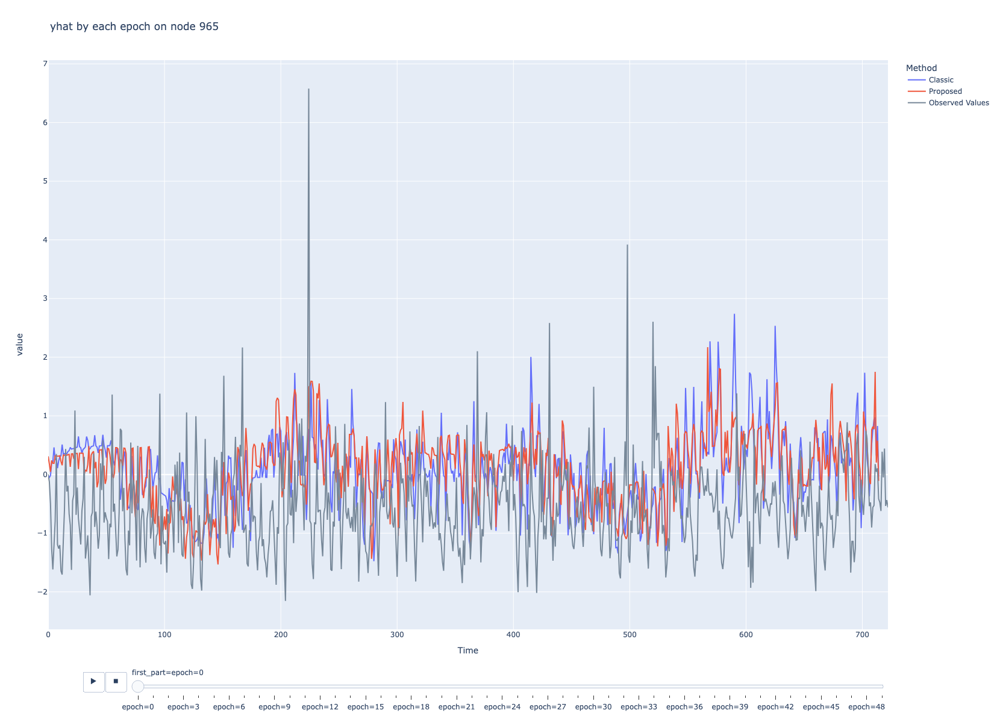

In [103]:
_figs[965]

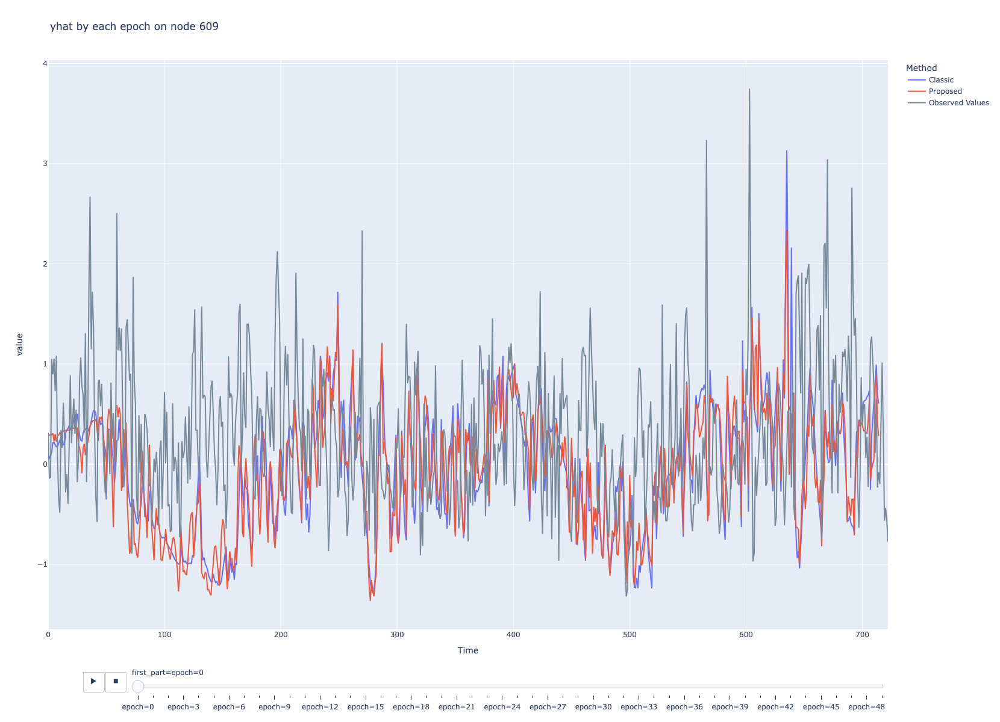

In [104]:
_figs[609]

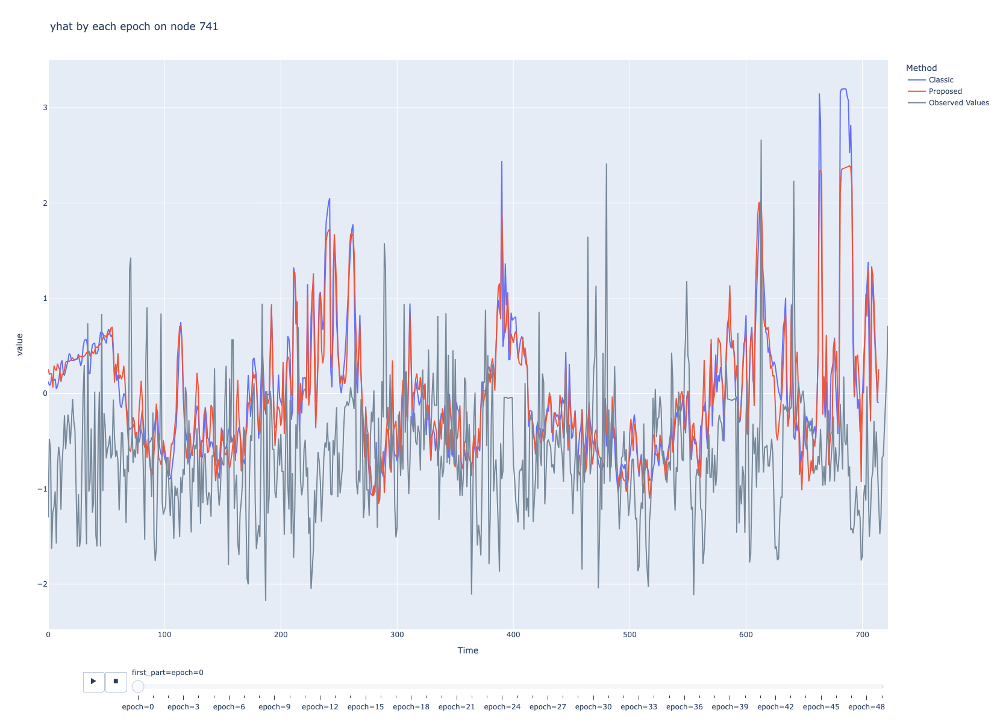

In [105]:
_figs[741]

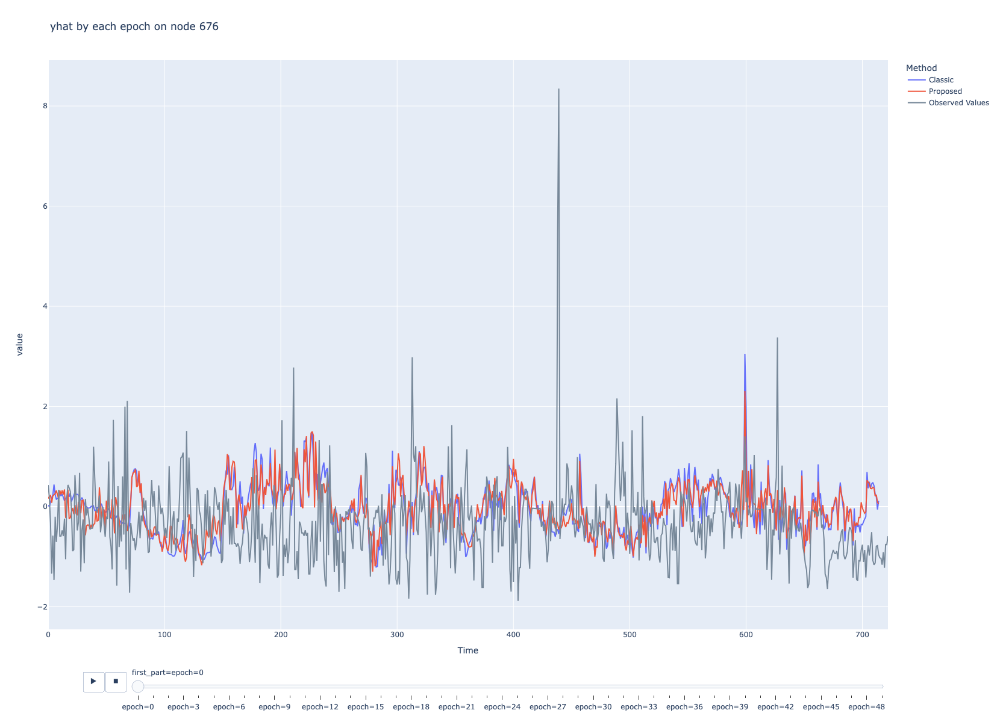

In [106]:
_figs[676]

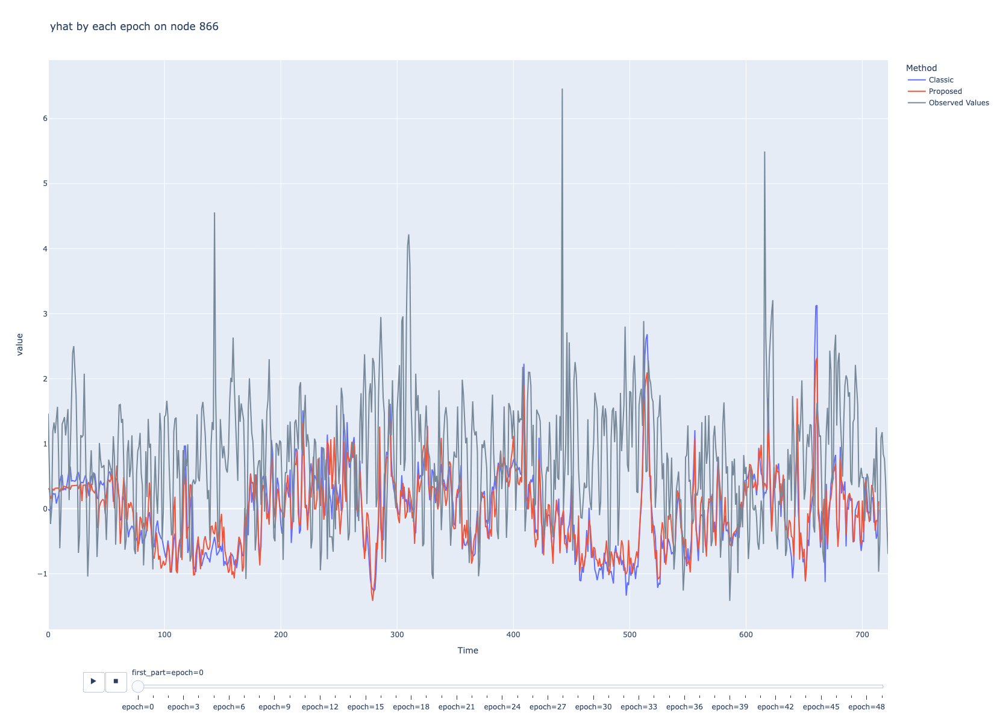

In [107]:
_figs[866]

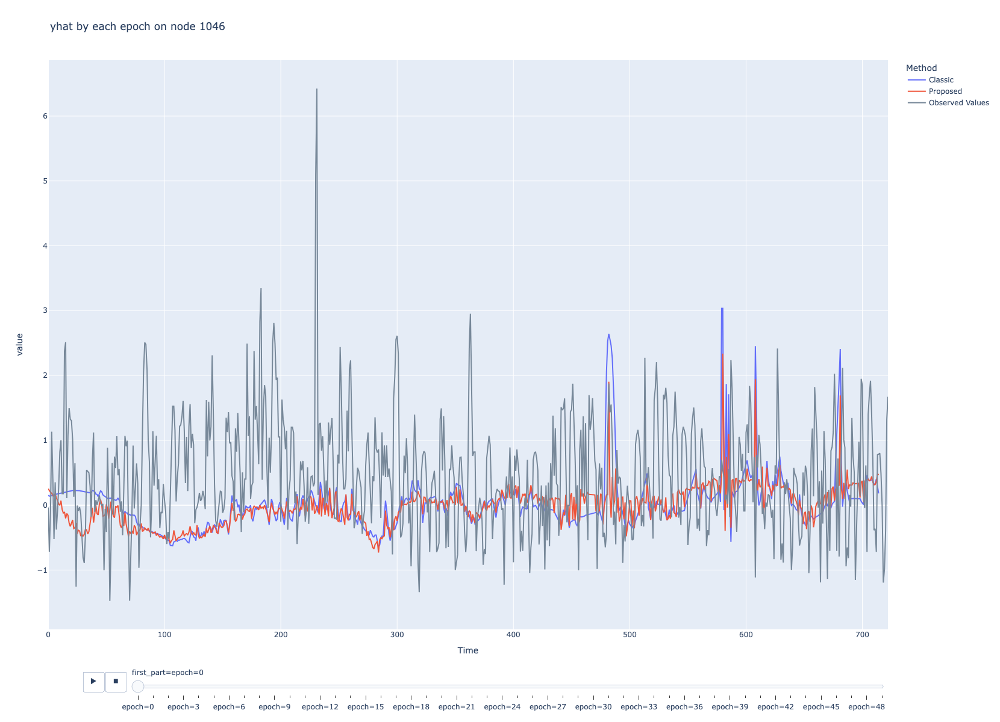

In [108]:
_figs[1046]

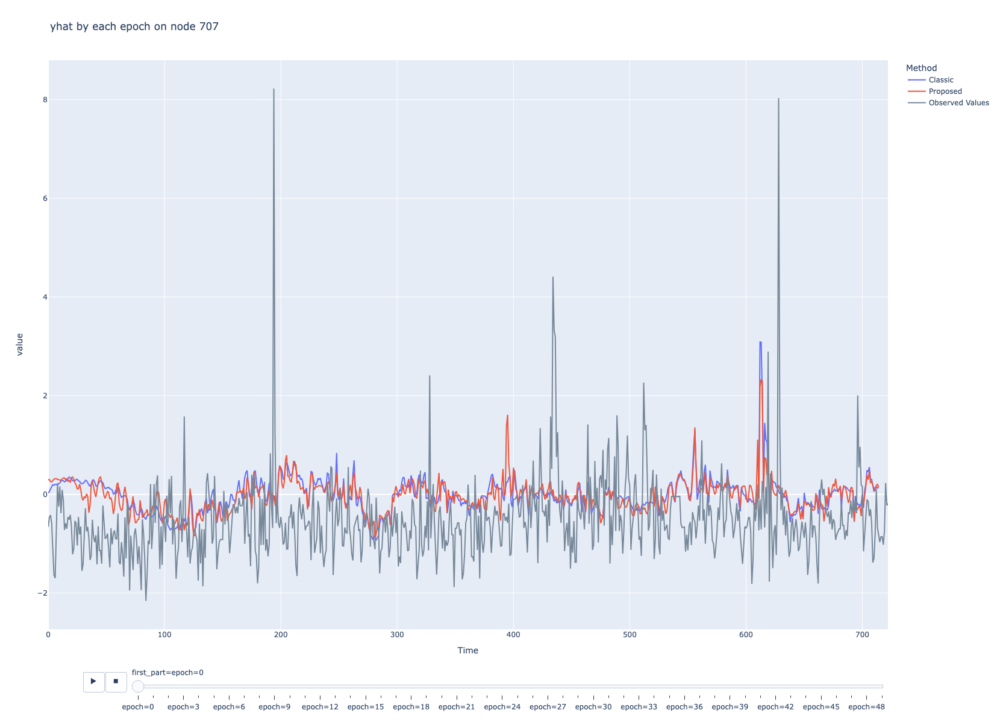

In [109]:
_figs[707]

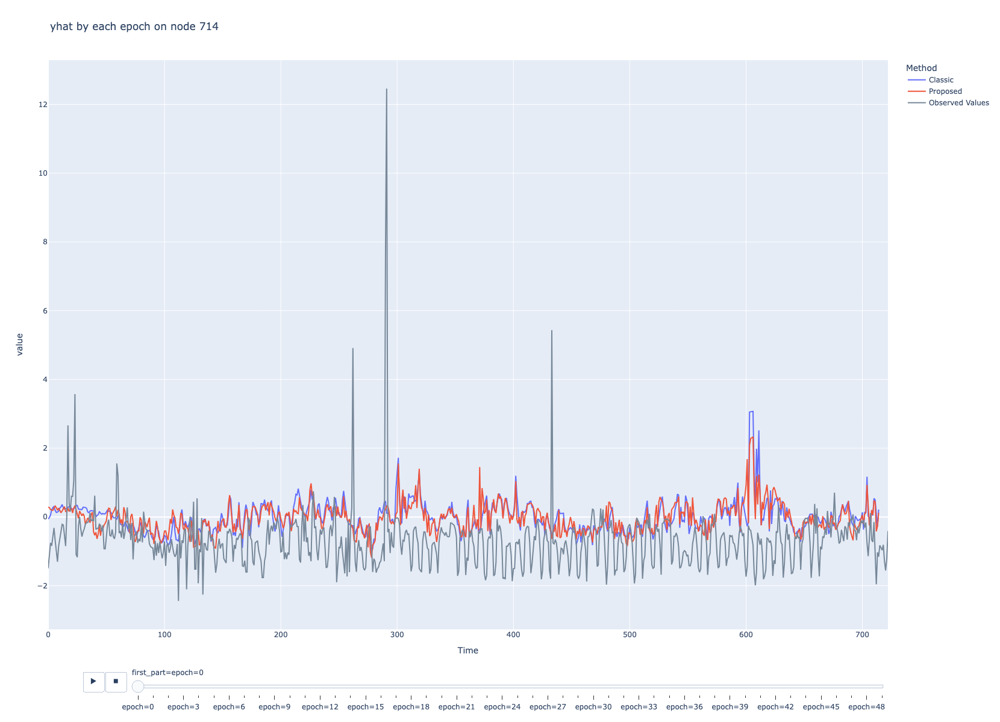

In [110]:
_figs[714]

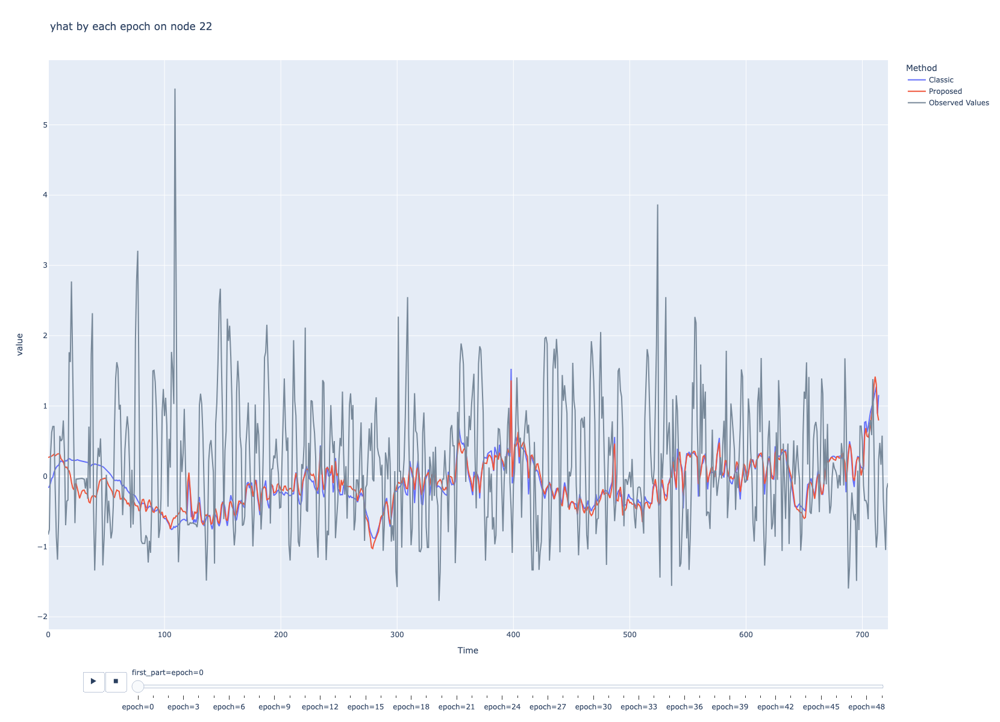

In [111]:
_figs[22]

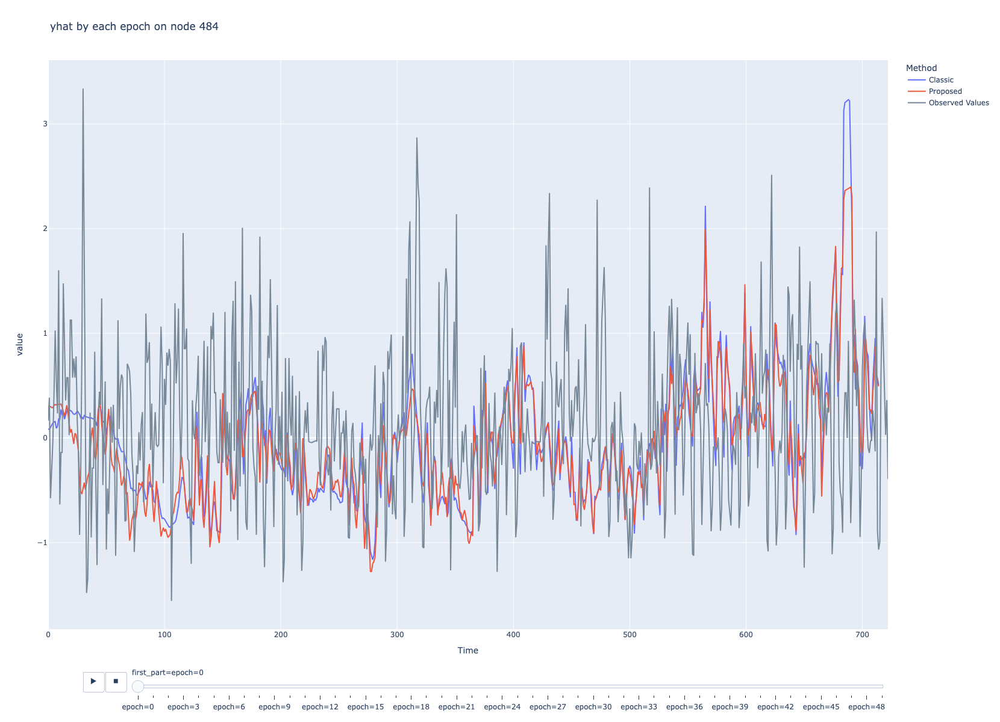

In [112]:
_figs[484]

In [79]:
import pickle

In [81]:
with open('wikimath_toy_figs.pkl', 'wb') as file:
    pickle.dump(_figs, file)

In [82]:
with open('wikimath_toy_figs.pkl', 'rb') as file:
    loaded_fig = pickle.load(file)